In [1]:
import pandas as pd
import itertools
import geopandas as gpd
import numpy as np
import os 
import json

from scipy.spatial.distance import cdist

from datetime import datetime, timedelta

from pprint import pp
#import torch
#import torch_geometric
from tqdm.notebook import tqdm

#from torch_geometric.data import HeteroData

import matplotlib.pyplot as plt

data_path='data'

In [2]:
target_pollutants='SO2 CO PM10 PM25 O3'.split()
synth_data_lenght= 1 #number of years of synthetic data to be used (in neta

### Read files

#### Air pollution data

Madrid
Real data

In [3]:
md_real_ap_df= pd.read_csv(os.path.join(data_path, '02_madrid_airpollution_clean.csv'), index_col=0, parse_dates=['date'])
md_real_ap_df= md_real_ap_df[md_real_ap_df['pollutant'].isin(target_pollutants)]
md_real_ap_df

,H00,H01,H02,H03,H04,H05,H06,H07,H08,H09,...,H17,H18,H19,H20,H21,H22,H23,id,date,pollutant
0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,28079004,2023-09-13,SO2
1,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,28079004,2023-09-14,SO2
2,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,28079004,2023-09-15,SO2
3,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,28079004,2023-09-16,SO2
4,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,28079004,2023-09-17,SO2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
205,28.0,23.0,22.0,21.0,19.0,19.0,25.0,16.0,14.0,34.0,...,27.0,22.0,25.0,30.0,37.0,56.0,41.0,28079047,2023-10-02,PM10
206,29.0,26.0,20.0,22.0,16.0,23.0,14.0,23.0,28.0,32.0,...,30.0,19.0,23.0,28.0,36.0,44.0,48.0,28079047,2023-10-03,PM10
207,38.0,28.0,21.0,27.0,36.0,47.0,51.0,45.0,55.0,54.0,...,106.0,87.0,77.0,74.0,40.0,19.0,8.0,28079049,2023-10-01,O3
208,16.0,32.0,30.0,29.0,38.0,47.0,45.0,31.0,14.0,8.0,...,96.0,87.0,78.0,60.0,22.0,9.0,8.0,28079049,2023-10-02,O3


Minimum date with real data

In [4]:
from dateutil.relativedelta import relativedelta

In [5]:
md_min_real_date= md_real_ap_df['date'].min()
md_min_synth_date= md_min_real_date + relativedelta(years=0-synth_data_lenght)
md_min_real_date, md_min_synth_date

(Timestamp('2023-09-13 00:00:00'), Timestamp('2022-09-13 00:00:00'))

In [6]:
md_pollutants_per_sensor_df= pd.read_csv(os.path.join(data_path, '02_madrid_pollutants_per_sensor.csv'), index_col=0)
md_pollutants_per_sensor_df

,id,pollutants
0,28079004,SO2 CO
1,28079008,SO2 CO PM25 PM10 O3
2,28079047,PM25 PM10
3,28079049,O3


Madrid synthetic data

In [7]:
md_synth_ap_df= pd.read_csv(os.path.join(data_path, 'madrid_airpollution_synth', 'madrid_pollution_synth.csv'), index_col=0, parse_dates=['date'])
md_synth_ap_df= md_synth_ap_df[md_synth_ap_df['pollutant'].isin(target_pollutants)]
md_synth_ap_df= md_synth_ap_df[(md_synth_ap_df['date']< md_min_real_date) & (md_synth_ap_df['date']>= md_min_synth_date)]
md_synth_ap_df

,H00,H01,H02,H03,H04,H05,H06,H07,H08,H09,...,H17,H18,H19,H20,H21,H22,H23,id,date,pollutant
15280,0.253895,0.100000,0.248330,0.251004,0.278879,0.254229,0.315027,0.313497,0.408496,0.263730,...,0.183400,0.177282,0.178066,0.223343,0.219274,0.214937,0.283020,28079008,2022-09-13,CO
15281,11.604231,18.043001,19.985003,14.698306,15.545658,15.365317,16.122547,13.307807,12.908388,15.672107,...,8.096141,10.744454,13.950721,21.428350,18.873657,23.288702,21.541954,28079008,2022-09-13,O3
15282,13.513970,13.517496,11.486073,13.790766,12.993001,3.075732,7.126786,5.591512,4.900537,4.094166,...,8.548830,8.355403,6.825534,7.901806,7.892766,7.354150,7.749166,28079008,2022-09-13,PM10
15283,4.033021,6.327529,5.287890,8.694930,9.734585,1.972161,4.253858,4.401873,2.919786,1.508086,...,2.410665,4.657189,2.808008,3.682723,2.450095,2.193703,3.174409,28079008,2022-09-13,PM25
15284,1.000037,1.000000,1.000110,1.000000,1.000000,1.000000,1.000000,1.000000,1.000001,1.000003,...,1.466621,1.626529,1.486523,1.674209,1.775710,1.003249,1.000151,28079008,2022-09-13,SO2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3416,52.686350,70.846330,80.477165,90.726234,97.779816,103.058800,102.378944,95.300630,80.937790,72.752815,...,28.198778,33.858917,36.245260,27.087112,14.845454,31.187313,36.328453,28079049,2023-09-08,O3
3417,57.685722,78.127716,80.704930,101.790570,111.247500,119.792630,114.680230,105.443665,92.414870,72.909560,...,56.768726,45.455185,44.252804,42.055973,50.765842,50.675694,51.081078,28079049,2023-09-09,O3
3418,51.774510,64.897480,63.817898,76.712685,80.720170,77.991890,77.434110,76.147125,71.069046,68.462560,...,43.612514,40.769283,36.509293,24.878553,10.524535,16.010204,36.110500,28079049,2023-09-10,O3
3419,56.794933,69.818080,75.564810,88.473625,93.730630,104.162840,101.352990,98.222600,86.942360,77.704994,...,46.371334,48.824490,48.983547,28.899874,17.267690,18.766530,37.777924,28079049,2023-09-11,O3


Merge real and synt data in a single dataframe

In [8]:
md_ap_df= pd.concat([md_real_ap_df,md_synth_ap_df])
md_ap_df= md_ap_df.reset_index(drop=True)
md_ap_df

,H00,H01,H02,H03,H04,H05,H06,H07,H08,H09,...,H17,H18,H19,H20,H21,H22,H23,id,date,pollutant
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,28079004,2023-09-13,SO2
1,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,28079004,2023-09-14,SO2
2,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,28079004,2023-09-15,SO2
3,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,28079004,2023-09-16,SO2
4,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,28079004,2023-09-17,SO2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3125,52.686350,70.846330,80.477165,90.726234,97.779816,103.05880,102.378944,95.300630,80.937790,72.752815,...,28.198778,33.858917,36.245260,27.087112,14.845454,31.187313,36.328453,28079049,2023-09-08,O3
3126,57.685722,78.127716,80.704930,101.790570,111.247500,119.79263,114.680230,105.443665,92.414870,72.909560,...,56.768726,45.455185,44.252804,42.055973,50.765842,50.675694,51.081078,28079049,2023-09-09,O3
3127,51.774510,64.897480,63.817898,76.712685,80.720170,77.99189,77.434110,76.147125,71.069046,68.462560,...,43.612514,40.769283,36.509293,24.878553,10.524535,16.010204,36.110500,28079049,2023-09-10,O3
3128,56.794933,69.818080,75.564810,88.473625,93.730630,104.16284,101.352990,98.222600,86.942360,77.704994,...,46.371334,48.824490,48.983547,28.899874,17.267690,18.766530,37.777924,28079049,2023-09-11,O3


Bilbao real data

In [9]:
bb_real_ap_df = pd.read_csv(os.path.join(data_path, '02_bilbao_airpollution_clean.csv'), index_col=0, parse_dates=['date'])
bb_real_ap_df= bb_real_ap_df[bb_real_ap_df['pollutant'].isin(target_pollutants)]
bb_real_ap_df

,date,pollutant,H00,H01,H02,H03,H04,H05,H06,H07,...,H15,H16,H17,H18,H19,H20,H21,H22,H23,id
0,2023-09-18,CO,0.20,0.20,0.22,0.22,0.22,0.23,0.23,0.23,...,0.21,0.20,0.23,0.24,0.27,0.27,0.27,0.25,0.25,MAZARREDO
1,2023-09-18,PM10,8.00,4.00,3.00,3.00,4.00,5.00,6.00,8.00,...,11.00,11.00,12.00,12.00,12.00,11.00,9.00,8.00,7.00,MAZARREDO
2,2023-09-18,PM25,3.00,2.00,1.00,1.00,1.00,2.00,2.00,2.00,...,5.00,5.00,6.00,6.00,6.00,5.00,4.00,4.00,3.00,MAZARREDO
3,2023-09-18,SO2,9.00,7.00,8.00,7.00,7.00,7.00,7.00,7.00,...,7.00,7.00,6.00,7.00,7.00,7.00,7.00,7.00,7.00,MAZARREDO
4,2023-09-19,CO,0.26,0.25,0.26,0.30,0.31,0.33,0.38,0.36,...,0.26,0.23,0.23,0.26,0.30,0.32,0.32,0.31,0.39,MAZARREDO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
139,2023-10-03,CO,0.30,0.27,0.30,0.33,0.33,0.36,0.42,0.45,...,0.26,0.28,0.30,0.30,0.32,0.29,0.30,0.26,0.23,M_DIAZ_HARO
140,2023-10-03,O3,37.00,36.00,30.00,17.00,13.00,10.00,10.00,11.00,...,33.00,30.00,32.00,39.00,44.00,50.00,46.00,48.00,57.00,M_DIAZ_HARO
141,2023-10-03,PM10,20.00,18.00,20.00,24.00,24.00,24.00,27.00,32.00,...,14.00,8.00,8.00,6.00,7.00,12.00,20.00,15.00,14.00,M_DIAZ_HARO
142,2023-10-03,PM25,15.00,14.00,15.00,19.00,19.00,18.00,19.00,20.00,...,7.00,5.00,5.00,4.00,5.00,7.00,9.00,9.00,6.00,M_DIAZ_HARO


In [10]:
bb_min_real_date= bb_real_ap_df['date'].min()
bb_min_synth_date= bb_min_real_date + relativedelta(years=0-synth_data_lenght)
bb_min_real_date, bb_min_synth_date

(Timestamp('2023-09-18 00:00:00'), Timestamp('2022-09-18 00:00:00'))

In [11]:
bb_pollutants_per_sensor_df= pd.read_csv(os.path.join(data_path, '02_bilbao_pollutants_per_sensor.csv'), index_col=0)
bb_pollutants_per_sensor_df

,id,pollutants
0,MAZARREDO,CO PM10 PM25 SO2
1,M_DIAZ_HARO,CO O3 PM10 PM25 SO2


Bilbao synt data

In [12]:
bb_synth_ap_df= pd.read_csv(os.path.join(data_path, 'bilbao_airpollution_synth', 'bilbao_pollution_synth.csv'), index_col=0, parse_dates=['date'])
bb_synth_ap_df= bb_synth_ap_df[bb_synth_ap_df['pollutant'].isin(target_pollutants)]
bb_synth_ap_df= bb_synth_ap_df[(bb_synth_ap_df['date']< bb_min_real_date) & (bb_synth_ap_df['date']>= bb_min_synth_date)]
bb_synth_ap_df

,H00,H01,H02,H03,H04,H05,H06,H07,H08,H09,...,H17,H18,H19,H20,H21,H22,H23,id,date,pollutant
12244,0.343194,0.335831,0.307865,0.231280,0.220456,0.244077,0.287341,0.338747,0.396052,0.443704,...,0.406067,0.444143,0.467604,0.514298,0.494856,0.382838,0.329639,MAZARREDO,2022-09-18,CO
12245,17.225271,25.354370,21.269712,15.493737,12.412559,11.918959,12.073310,12.671173,12.978588,16.574528,...,23.308490,24.673111,30.734743,34.902367,40.533860,29.414206,17.657070,MAZARREDO,2022-09-18,PM10
12246,7.716796,10.686128,10.304797,7.180089,5.861852,6.399250,6.371677,7.186795,8.169552,8.985732,...,17.218668,15.805851,16.424952,19.441025,19.515919,12.905363,8.704251,MAZARREDO,2022-09-18,PM25
12247,6.736408,6.470349,7.178531,7.791874,6.537728,6.831576,6.765191,5.764630,5.967527,5.848099,...,15.032878,14.885314,15.717756,18.974110,25.287050,26.222275,14.910248,MAZARREDO,2022-09-18,SO2
12248,0.326240,0.289286,0.302993,0.238219,0.235554,0.186380,0.208908,0.225526,0.239451,0.268735,...,0.203660,0.195483,0.215587,0.523809,0.446805,0.276023,0.282730,MAZARREDO,2022-09-19,CO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17125,0.334971,0.280493,0.303914,0.293484,0.309966,0.313430,0.320197,0.368400,0.399927,0.425375,...,0.357306,0.385245,0.380427,0.387728,0.412578,0.359424,0.412206,M_DIAZ_HARO,2023-09-17,CO
17126,50.281055,60.822018,60.280370,62.543230,54.983510,52.282497,40.879920,33.742380,19.258427,16.036000,...,10.002110,10.002600,10.020021,12.430639,16.827682,22.579514,24.689447,M_DIAZ_HARO,2023-09-17,O3
17127,18.022820,12.153633,12.046106,12.098572,10.535433,13.163832,14.946222,13.118465,15.365732,14.349206,...,22.766447,22.751041,24.568909,19.769440,18.221312,18.791230,21.903334,M_DIAZ_HARO,2023-09-17,PM10
17128,11.009215,8.675527,8.294737,7.695126,5.689318,8.112495,6.781737,7.927515,10.239179,9.785788,...,16.052742,19.921755,19.969645,17.592848,13.512096,12.250664,12.197794,M_DIAZ_HARO,2023-09-17,PM25


In [13]:
bb_ap_df= pd.concat([bb_real_ap_df,bb_synth_ap_df])
bb_ap_df= bb_ap_df.reset_index(drop=True)
bb_ap_df

,date,pollutant,H00,H01,H02,H03,H04,H05,H06,H07,...,H15,H16,H17,H18,H19,H20,H21,H22,H23,id
0,2023-09-18,CO,0.200000,0.200000,0.220000,0.220000,0.220000,0.230000,0.230000,0.230000,...,0.210000,0.200000,0.230000,0.240000,0.270000,0.270000,0.270000,0.250000,0.250000,MAZARREDO
1,2023-09-18,PM10,8.000000,4.000000,3.000000,3.000000,4.000000,5.000000,6.000000,8.000000,...,11.000000,11.000000,12.000000,12.000000,12.000000,11.000000,9.000000,8.000000,7.000000,MAZARREDO
2,2023-09-18,PM25,3.000000,2.000000,1.000000,1.000000,1.000000,2.000000,2.000000,2.000000,...,5.000000,5.000000,6.000000,6.000000,6.000000,5.000000,4.000000,4.000000,3.000000,MAZARREDO
3,2023-09-18,SO2,9.000000,7.000000,8.000000,7.000000,7.000000,7.000000,7.000000,7.000000,...,7.000000,7.000000,6.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,MAZARREDO
4,2023-09-19,CO,0.260000,0.250000,0.260000,0.300000,0.310000,0.330000,0.380000,0.360000,...,0.260000,0.230000,0.230000,0.260000,0.300000,0.320000,0.320000,0.310000,0.390000,MAZARREDO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3424,2023-09-17,CO,0.334971,0.280493,0.303914,0.293484,0.309966,0.313430,0.320197,0.368400,...,0.342525,0.364906,0.357306,0.385245,0.380427,0.387728,0.412578,0.359424,0.412206,M_DIAZ_HARO
3425,2023-09-17,O3,50.281055,60.822018,60.280370,62.543230,54.983510,52.282497,40.879920,33.742380,...,10.879993,10.152094,10.002110,10.002600,10.020021,12.430639,16.827682,22.579514,24.689447,M_DIAZ_HARO
3426,2023-09-17,PM10,18.022820,12.153633,12.046106,12.098572,10.535433,13.163832,14.946222,13.118465,...,21.745214,19.186134,22.766447,22.751041,24.568909,19.769440,18.221312,18.791230,21.903334,M_DIAZ_HARO
3427,2023-09-17,PM25,11.009215,8.675527,8.294737,7.695126,5.689318,8.112495,6.781737,7.927515,...,13.862837,14.002815,16.052742,19.921755,19.969645,17.592848,13.512096,12.250664,12.197794,M_DIAZ_HARO


#### Traffic data

Madrid

Real data

In [14]:
md_traffic_files = [archivo for archivo in os.listdir(os.path.join(data_path, 'madrid_trafico')) if not archivo.startswith('.')]

traffic_df_lst=[]
for f in md_traffic_files:
    _df= pd.read_csv(os.path.join(data_path, 'madrid_trafico',f), parse_dates=['DateTime'])
    trf_id= f.split('_')[2]
    _df['id']=trf_id[1:] # We remove the first character as it is a 0
    traffic_df_lst.append(_df)

md_real_trf_df= pd.concat(traffic_df_lst, axis=0)
md_real_trf_df.head()

,DateTime,Car,Motorcycle,Bus,Truck,id
0,2023-09-13 10:00:00,170,1,20,46,1302
1,2023-09-13 11:00:00,124,0,14,36,1302
2,2023-09-13 12:00:00,178,1,28,37,1302
3,2023-09-13 13:00:00,158,4,26,21,1302
4,2023-09-13 14:00:00,160,20,40,23,1302


In [15]:
md_real_trf_df['id'].nunique()

13

In [16]:
md_real_trf_ids= md_real_trf_df['id'].unique()
md_real_trf_ids

array(['1302', '1303', '1304', '1305', '1316', '1317', '1318', '1323',
       '1324', '1331', '1332', '4308', '4322'], dtype=object)

In [17]:
md_min_real_trf_date= md_real_trf_df['DateTime'].min()
md_min_synth_trf_date= md_min_real_trf_date + relativedelta(years=0-synth_data_lenght)
md_min_real_trf_date, md_min_synth_trf_date

(Timestamp('2023-09-13 10:00:00'), Timestamp('2022-09-13 10:00:00'))

Synthetic data

In [18]:
md_synth_trf_df= pd.read_csv(os.path.join(data_path, 'madrid_trafico_synth', 'madrid_traffic_synth.csv'), dtype={'id':str}, index_col=0, parse_dates=['DateTime'])
md_synth_trf_df= md_synth_trf_df[(md_synth_trf_df['DateTime']< md_min_real_trf_date) & (md_synth_trf_df['DateTime']>= md_min_synth_trf_date)]
print(md_synth_trf_df['id'].unique())
md_synth_trf_df= md_synth_trf_df[md_synth_trf_df['id'].isin(md_real_trf_ids)]
md_synth_trf_df

['4322' '1331' '1316' '1305' '4308' '1323' '1318' '1302' '1324' '1304'
 '1332' '1303' '1317']


,DateTime,Car,Motorcycle,Bus,Truck,id
73341,2022-09-13 10:00:00,27,0,0,1,4322
73342,2022-09-13 11:00:00,28,0,1,2,4322
73343,2022-09-13 12:00:00,21,1,2,1,4322
73344,2022-09-13 13:00:00,84,4,4,15,4322
73345,2022-09-13 14:00:00,74,2,6,25,4322
...,...,...,...,...,...,...
82096,2023-09-13 05:00:00,76,0,4,2,1317
82097,2023-09-13 06:00:00,26,0,2,2,1317
82098,2023-09-13 07:00:00,98,0,2,2,1317
82099,2023-09-13 08:00:00,-9223372036854775808,0,1,1,1317


In [19]:
md_synth_trf_df['id'].nunique()

13

In [20]:
md_synth_trf_df['id'].unique()

array(['4322', '1331', '1316', '1305', '4308', '1323', '1318', '1302',
       '1324', '1304', '1332', '1303', '1317'], dtype=object)

In [21]:
md_trf_df= pd.concat([md_real_trf_df,md_synth_trf_df])
md_trf_df= md_trf_df.reset_index(drop=True)
md_trf_df

,DateTime,Car,Motorcycle,Bus,Truck,id
0,2023-09-13 10:00:00,170,1,20,46,1302
1,2023-09-13 11:00:00,124,0,14,36,1302
2,2023-09-13 12:00:00,178,1,28,37,1302
3,2023-09-13 13:00:00,158,4,26,21,1302
4,2023-09-13 14:00:00,160,20,40,23,1302
...,...,...,...,...,...,...
120258,2023-09-13 05:00:00,76,0,4,2,1317
120259,2023-09-13 06:00:00,26,0,2,2,1317
120260,2023-09-13 07:00:00,98,0,2,2,1317
120261,2023-09-13 08:00:00,-9223372036854775808,0,1,1,1317


Bilbao

In [22]:
target_trf_bilbao='37 42 8 41 4 30 68 69 52 44 5  32 33 34 35 65 72'.split()
bb_traffic_files = [archivo for archivo in os.listdir(os.path.join(data_path, 'bilbao_trafico')) if not archivo.startswith('.')]

bb_traffic_df_lst=[]
for f in bb_traffic_files:
    _df= pd.read_csv(os.path.join(data_path, 'bilbao_trafico',f), parse_dates=['DateTime'])
    sensor_num= f.split('_')[2]
    if sensor_num in target_trf_bilbao:
        _df['id']=str(sensor_num)
        bb_traffic_df_lst.append(_df)
        
bb_real_trf_df= pd.concat(bb_traffic_df_lst, axis=0)
bb_real_trf_df.head()        

,DateTime,Car,Motorcycle,Bus,Truck,id
0,2023-09-18 08:00:00,10,0,0,1,30
1,2023-09-18 09:00:00,32,0,3,3,30
2,2023-09-18 10:00:00,40,0,3,3,30
3,2023-09-18 11:00:00,22,0,2,2,30
4,2023-09-18 12:00:00,0,0,0,0,30


In [23]:
bb_real_trf_df['id'].nunique()

17

In [24]:
bb_real_trf_ids= bb_real_trf_df['id'].unique()
bb_real_trf_ids

array(['30', '32', '33', '34', '35', '37', '41', '42', '44', '4', '52',
       '5', '65', '68', '69', '72', '8'], dtype=object)

In [25]:
bb_min_real_trf_date= bb_real_trf_df['DateTime'].min()
bb_min_synth_trf_date= bb_min_real_trf_date + relativedelta(years=0-synth_data_lenght)
bb_min_real_trf_date, bb_min_synth_trf_date

(Timestamp('2023-09-18 08:00:00'), Timestamp('2022-09-18 08:00:00'))

Synthetic data

In [26]:
bb_synth_trf_df= pd.read_csv(os.path.join(data_path, 'bilbao_trafico_synth', 'bilbao_traffic_synth.csv'),  dtype={'id':str}, index_col=0, parse_dates=['DateTime'])
bb_synth_trf_df= bb_synth_trf_df[(bb_synth_trf_df['DateTime']< bb_min_real_trf_date) & (bb_synth_trf_df['DateTime']>= bb_min_synth_trf_date)]
bb_synth_trf_df= bb_synth_trf_df[bb_synth_trf_df['id'].isin(bb_real_trf_ids)]
bb_synth_trf_df

,DateTime,Car,Motorcycle,Bus,Truck,id
73459,2022-09-18 08:00:00,60,0,0,0,4
73460,2022-09-18 09:00:00,50,0,0,0,4
73461,2022-09-18 10:00:00,62,0,0,1,4
73462,2022-09-18 11:00:00,69,0,0,1,4
73463,2022-09-18 12:00:00,75,1,9,5,4
...,...,...,...,...,...,...
82214,2023-09-18 03:00:00,9,0,3,1,68
82215,2023-09-18 04:00:00,14,1,1,1,68
82216,2023-09-18 05:00:00,4,0,1,0,68
82217,2023-09-18 06:00:00,1,0,0,1,68


In [27]:
bb_synth_trf_df['id'].nunique()

17

In [28]:
bb_synth_trf_df['id'].unique()

array(['4', '52', '34', '65', '8', '42', '35', '32', '5', '44', '33',
       '30', '37', '41', '69', '72', '68'], dtype=object)

In [29]:
bb_trf_df= pd.concat([bb_real_trf_df,bb_synth_trf_df])
bb_trf_df= bb_trf_df.reset_index(drop=True)
bb_trf_df

,DateTime,Car,Motorcycle,Bus,Truck,id
0,2023-09-18 08:00:00,10,0,0,1,30
1,2023-09-18 09:00:00,32,0,3,3,30
2,2023-09-18 10:00:00,40,0,3,3,30
3,2023-09-18 11:00:00,22,0,2,2,30
4,2023-09-18 12:00:00,0,0,0,0,30
...,...,...,...,...,...,...
155086,2023-09-18 03:00:00,9,0,3,1,68
155087,2023-09-18 04:00:00,14,1,1,1,68
155088,2023-09-18 05:00:00,4,0,1,0,68
155089,2023-09-18 06:00:00,1,0,0,1,68


#### Sensors' location

In [30]:
sensors_loc_gdf= gpd.read_file(os.path.join(data_path,'01_sensors_location.geojson'), driver='GeoJSON')  
sensors_loc_gdf['id']= sensors_loc_gdf['id'].replace('Mª DIAZ HARO','M_DIAZ_HARO') 
sensors_loc_gdf.head()

,id,lat,lon,type,geometry
0,1305,40.407658,-3.693109,camera,POINT (-3.69311 40.40766)
1,1304,40.409189,-3.692159,camera,POINT (-3.69216 40.40919)
2,1302,40.418975,-3.693114,camera,POINT (-3.69311 40.41898)
3,1317,40.418890,-3.696665,camera,POINT (-3.69667 40.41889)
4,1318,40.416659,-3.700281,camera,POINT (-3.70028 40.41666)


In [31]:
sensors_loc_gdf.tail()

,id,lat,lon,type,geometry
83,28079059,40.460726,-3.616341,airpollution,POINT (-3.61634 40.46073)
84,28079060,40.500548,-3.689731,airpollution,POINT (-3.68973 40.50055)
85,MAZARREDO,43.267506,-2.935188,airpollution,POINT (-2.93519 43.26751)
86,M_DIAZ_HARO,43.258803,-2.945657,airpollution,POINT (-2.94566 43.25880)
87,EUROPA,43.254911,-2.902376,airpollution,POINT (-2.90238 43.25491)


In [32]:
def haversine(coord1, coord2):
    """
    Calcular la distancia Haversine entre dos coordenadas geográficas en grados decimales.
    """
    lon1, lat1 = coord1
    lon2, lat2 = coord2
    R = 6371  # Radio de la Tierra en kilómetros

    # Convertir grados decimales a radianes
    lat1, lon1, lat2, lon2 = map(np.radians, [lat1, lon1, lat2, lon2])

    # Calcular diferencias de longitud y latitud
    dlat = lat2 - lat1
    dlon = lon2 - lon1

    # Calcular la distancia Haversine
    a = np.sin(dlat / 2) ** 2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon / 2) ** 2
    c = 2 * np.arcsin(np.sqrt(a))
    distancia = R * c
    return distancia

def generar_matriz_distancias_haversine(geodataframe, columna_id):
    # Extraer las coordenadas de los puntos en el GeoDataFrame
    puntos = geodataframe.geometry.apply(lambda geom: (geom.x, geom.y)).tolist()
    
    # Calcular la matriz de distancias usando la distancia Haversine
    matriz_distancias = cdist(puntos, puntos, haversine)
    
    # Asignar los IDs como índices y columnas en el DataFrame de la matriz de distancias
    matriz_distancias_df = pd.DataFrame(matriz_distancias, index=geodataframe[columna_id], columns=geodataframe[columna_id])
    
    return matriz_distancias_df

matriz_distancias_haversine = generar_matriz_distancias_haversine(sensors_loc_gdf, 'id')
print(matriz_distancias_haversine)

id                 1305        1304        1302        1317        1318  \
id                                                                        
1305           0.000000    0.188304    1.258458    1.284755    1.170662   
1304           0.188304    0.000000    1.091215    1.144221    1.078349   
1302           1.258458    1.091215    0.000000    0.300815    0.659193   
1317           1.284755    1.144221    0.300815    0.000000    0.394034   
1318           1.170662    1.078349    0.659193    0.394034    0.000000   
...                 ...         ...         ...         ...         ...   
28079059       8.777028    8.603270    7.985351    8.237116    8.629932   
28079060      10.332829   10.160709    9.074931    9.098829    9.370616   
MAZARREDO    324.135882  323.953482  322.900362  322.966959  323.269057   
M_DIAZ_HARO  323.020143  322.837836  321.784151  321.850167  322.151763   
EUROPA       323.302778  323.119968  322.069445  322.138666  322.443016   

id                 4308 

In [33]:
def generar_lista_de_fechas(inicio, fin):
    lista_fechas = []
    fecha_actual = inicio
    while fecha_actual <= fin:
        lista_fechas.append(fecha_actual)
        fecha_actual += timedelta(days=1)
    return lista_fechas

### Study of missing values (Nan)

Bilbao

In [34]:
bb_trf_df['id'].unique()

array(['30', '32', '33', '34', '35', '37', '41', '42', '44', '4', '52',
       '5', '65', '68', '69', '72', '8'], dtype=object)

In [35]:
vehicle_types= 'Car Motorcycle Bus Truck'.split()

for vt in vehicle_types:
    v_df= bb_trf_df[['DateTime', 'id', vt]]
    v_df= v_df.pivot_table(index='DateTime', columns='id', values=vt)
    #print(v_df)
    print(vt, v_df.isna().sum())

Car id
30    0
32    0
33    0
34    0
35    0
37    0
4     0
41    0
42    0
44    0
5     0
52    0
65    0
68    0
69    0
72    0
8     0
dtype: int64
Motorcycle id
30    0
32    0
33    0
34    0
35    0
37    0
4     0
41    0
42    0
44    0
5     0
52    0
65    0
68    0
69    0
72    0
8     0
dtype: int64
Bus id
30    0
32    0
33    0
34    0
35    0
37    0
4     0
41    0
42    0
44    0
5     0
52    0
65    0
68    0
69    0
72    0
8     0
dtype: int64
Truck id
30    0
32    0
33    0
34    0
35    0
37    0
4     0
41    0
42    0
44    0
5     0
52    0
65    0
68    0
69    0
72    0
8     0
dtype: int64


Madrid

In [36]:
for vt in vehicle_types:
    v_df= md_trf_df[['DateTime', 'id', vt]]
    v_df= v_df.pivot_table(index='DateTime', columns='id', values=vt)
    print(vt, v_df.isna().sum())

Car id
1302    0
1303    0
1304    0
1305    0
1316    0
1317    0
1318    0
1323    0
1324    0
1331    0
1332    0
4308    0
4322    0
dtype: int64
Motorcycle id
1302    0
1303    0
1304    0
1305    0
1316    0
1317    0
1318    0
1323    0
1324    0
1331    0
1332    0
4308    0
4322    0
dtype: int64
Bus id
1302    0
1303    0
1304    0
1305    0
1316    0
1317    0
1318    0
1323    0
1324    0
1331    0
1332    0
4308    0
4322    0
dtype: int64
Truck id
1302    0
1303    0
1304    0
1305    0
1316    0
1317    0
1318    0
1323    0
1324    0
1331    0
1332    0
4308    0
4322    0
dtype: int64


### Plot data

#### Traffic data

In [37]:
def plot_traffic_data(trf_df):
    for vt in vehicle_types:
        v_df= md_trf_df[['DateTime', 'id', vt]]
        v_df= v_df.pivot_table(index='DateTime', columns='id', values=vt)
        v_df['max']= v_df.apply(lambda r: r.max(), axis=1)
        v_df['min']= v_df.apply(lambda r: r.min(), axis=1)
        v_df['mean']= v_df.apply(lambda r: r.mean(), axis=1)
        v_df_resampled= v_df['mean max min'.split()].resample("D").mean()
        v_df_resampled.plot(figsize=(15,5),grid=True, title=vt);

Bilbao

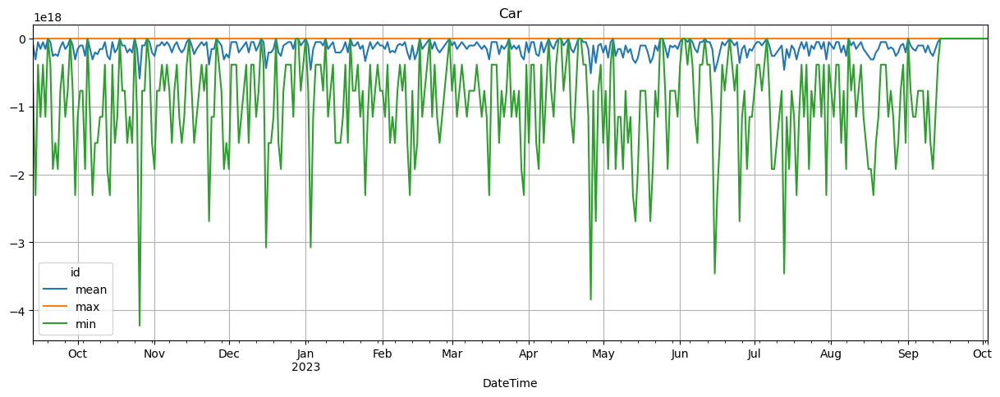

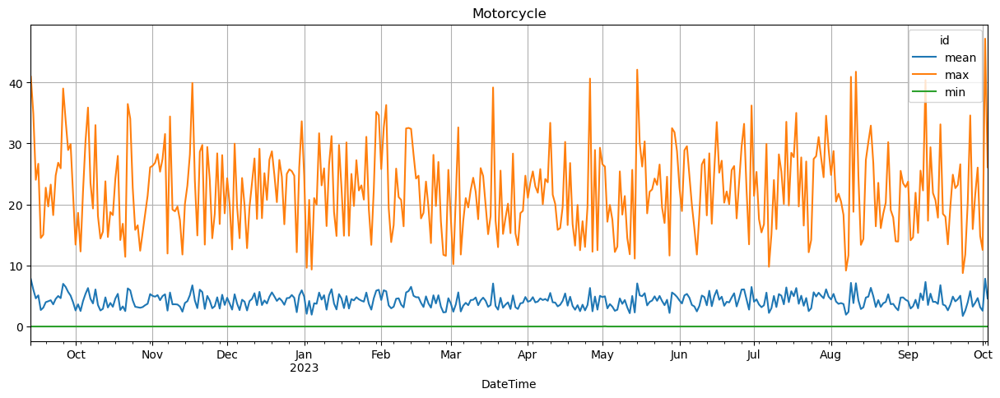

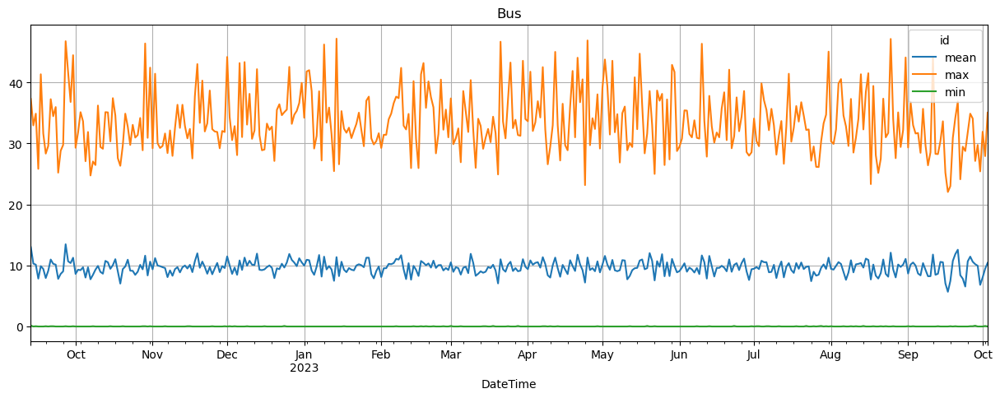

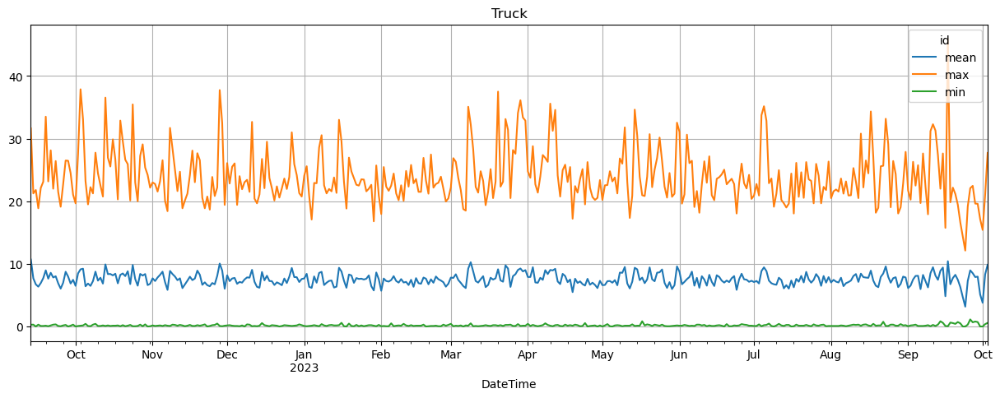

In [38]:
plot_traffic_data(bb_trf_df)

Madrid

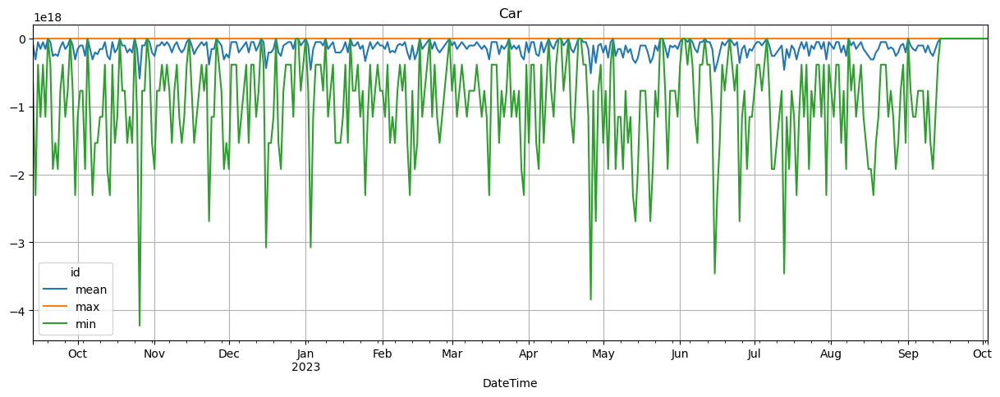

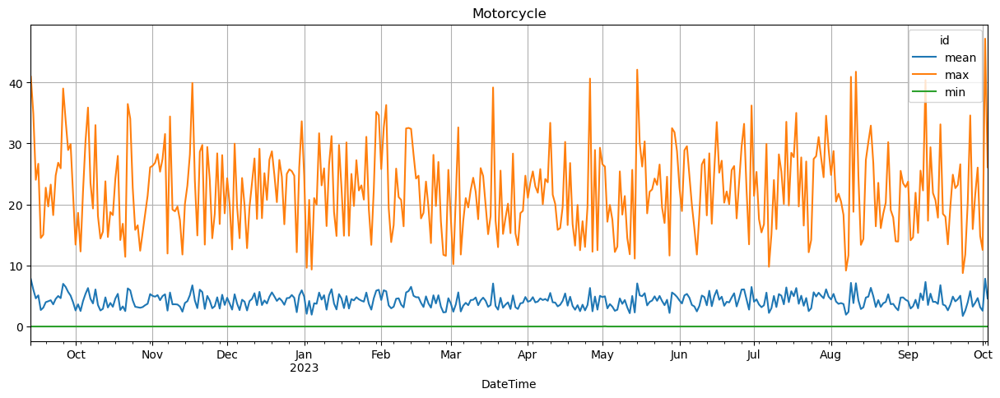

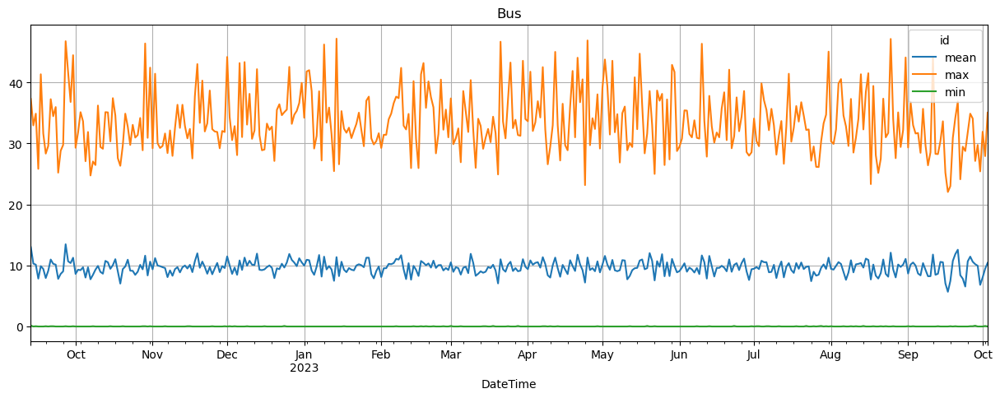

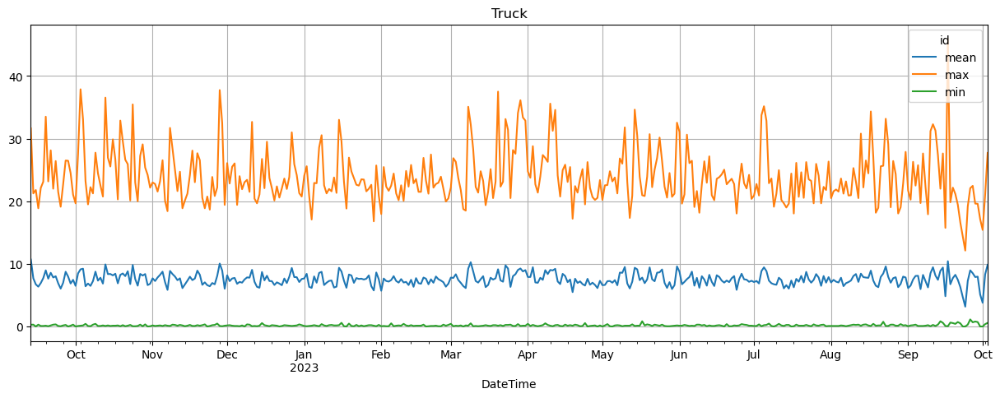

In [39]:
plot_traffic_data(md_trf_df)

#### Pollution data

In [40]:
def plot_ap(ap_df):
    melted_df = pd.melt(ap_df, id_vars=['id', 'date', 'pollutant'], 
                        value_vars=[f'H{i:02d}' for i in range(0, 24)],
                        var_name='Hora_old', value_name='Valor')
    melted_df['hour']= melted_df['Hora_old'].apply(lambda h: int(h[1:]))
    melted_df['date_str']= melted_df['date'].apply(lambda d: d.strftime('%Y-%m-%d'))
    melted_df['datetime_str']= melted_df.apply(lambda r: r['date_str']+' '+ str(r['hour'])+':00:00',axis=1)
    melted_df['datetime']= pd.to_datetime(melted_df['datetime_str'])
    melted_df= melted_df.drop(columns='date Hora_old hour date_str datetime_str'.split())
    
    for p in ap_df['pollutant'].unique():
        pollutant_df= melted_df[melted_df['pollutant']==p]
        pollutant_df= pollutant_df.pivot_table(index='datetime', columns='id', values='Valor')
        pollutant_df['max']= pollutant_df.apply(lambda r: r.max(), axis=1)
        pollutant_df['min']= pollutant_df.apply(lambda r: r.min(), axis=1)
        pollutant_df['mean']= pollutant_df.apply(lambda r: r.mean(), axis=1)
        pollutant_resampled_df= pollutant_df['mean max min'.split()].resample("D").mean()
        pollutant_resampled_df.plot(figsize=(15,5),grid=True, title=p, logy=True);

Bilbao

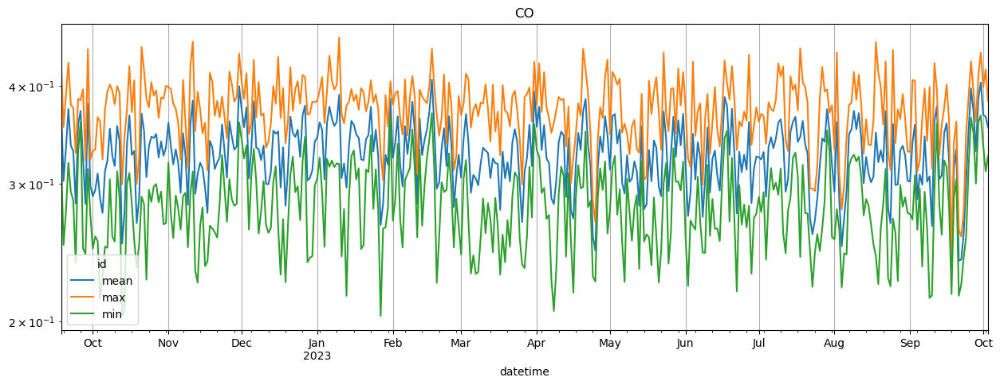

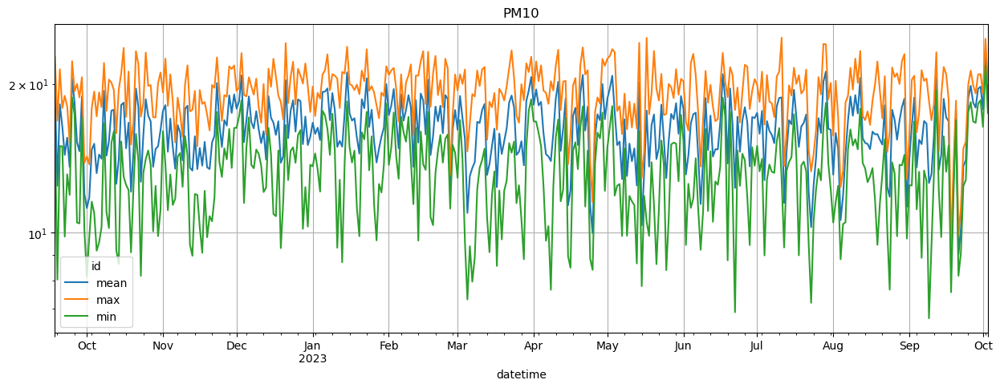

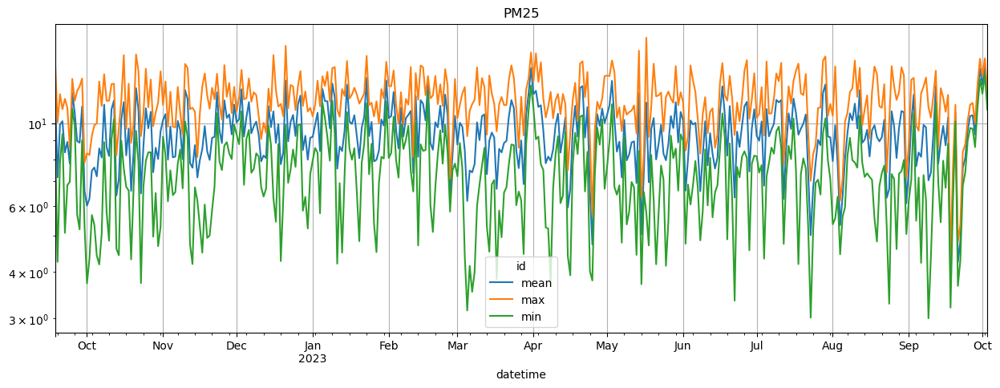

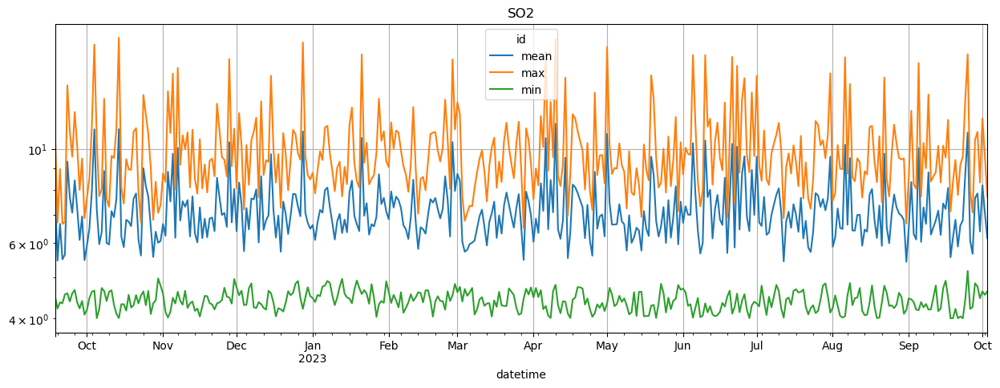

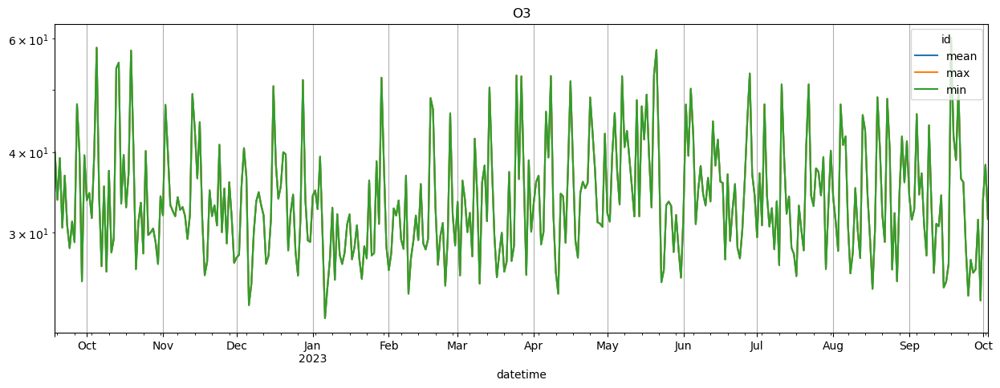

In [41]:
plot_ap(bb_ap_df)

Madrid

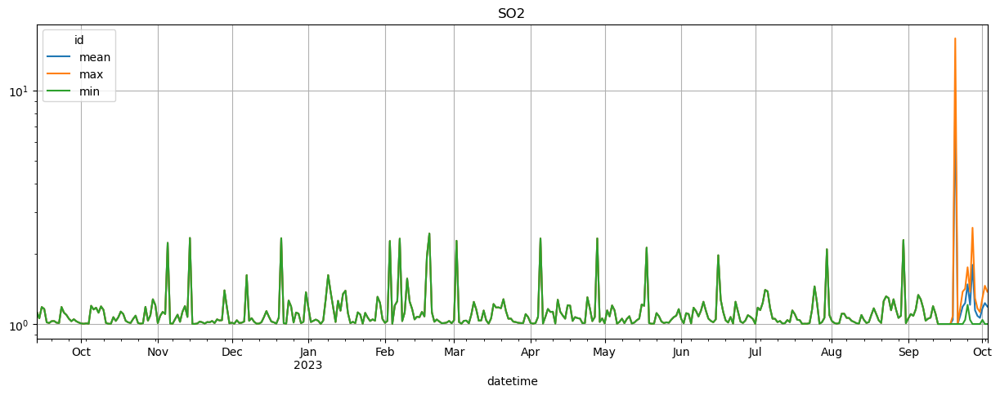

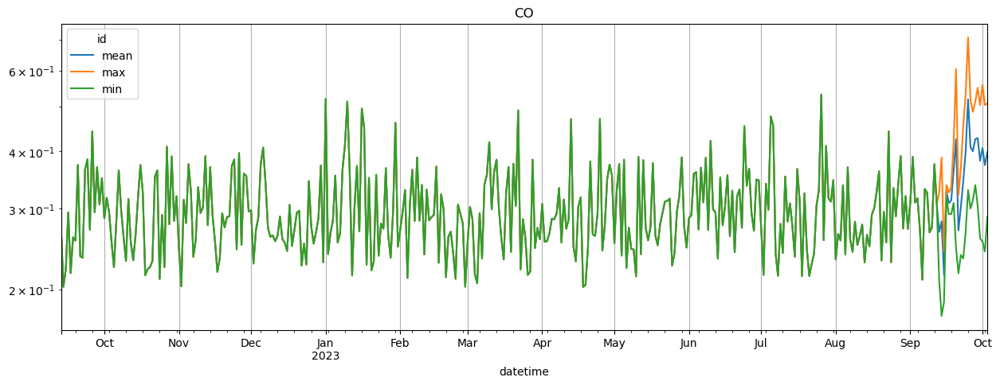

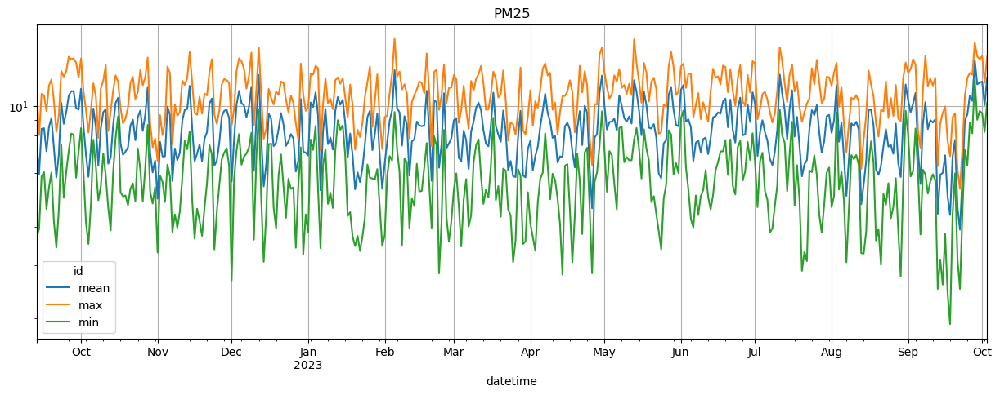

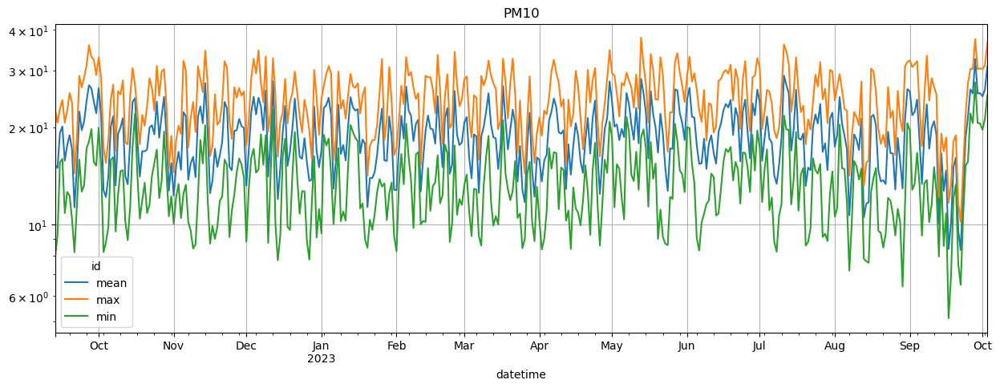

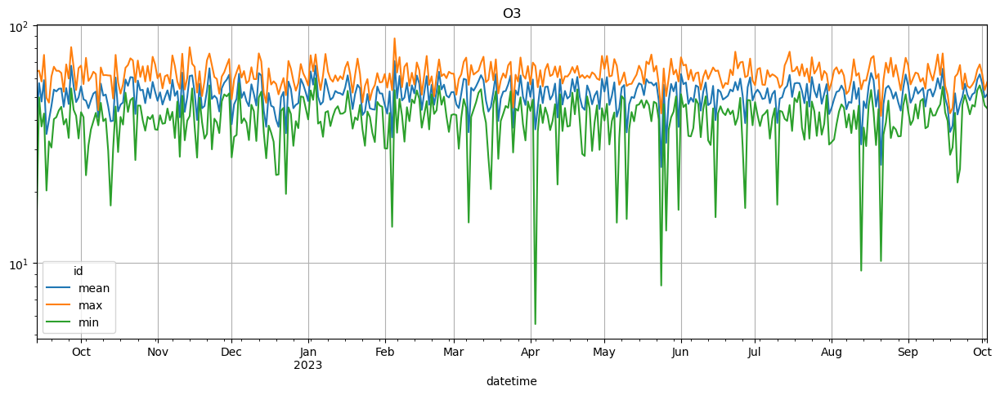

In [42]:
plot_ap(md_ap_df)

### Generate graphs

In [43]:
def generate_graph(ap_id_dict, trf_id_dict, ap_sensors_id, trf_sensors_id, lista_de_fechas_str, trf_df, ap_df):

    dataset={}
    dataset['node_ids']={}
    dataset['node_ids']['trf']=trf_id_dict

    dataset['columns_ids']={}
    dataset['node_ids']['trf']=trf_id_dict

    
    for id_,i in ap_id_dict.items():
        dataset['node_ids'][f'ap{i}']={str(id_):0}
    
    dataset['edges']={}
    dataset['edges_attr']={}

    trf_trf_edges=[]
    trf_trf_edges_attr=[]
    for s1,s2 in itertools.combinations(trf_sensors_id,2):
        i1= trf_id_dict[s1]
        i2= trf_id_dict[s2]

        trf_trf_edges.append([i1,i2])
        trf_trf_edges.append([i2,i1])

        trf_trf_edges_attr.append(matriz_distancias_haversine.at[str(s1),str(s2)])
        trf_trf_edges_attr.append(matriz_distancias_haversine.at[str(s2),str(s1)])
    
    dataset['edges']['trf_close_trf']= trf_trf_edges
    dataset['edges_attr']['trf_close_trf']= trf_trf_edges_attr
   
    for s1,s2 in itertools.combinations(ap_sensors_id,2):
        i1= ap_id_dict[s1]
        i2= ap_id_dict[s2]
        l1= dataset['edges'].get(f'ap{i1}_close_ap{i2}',[])
        l2= dataset['edges'].get(f'ap{i2}_close_ap{i1}',[])
        
        n1=dataset['node_ids'][f'ap{i1}'][str(s1)]
        n2=dataset['node_ids'][f'ap{i2}'][str(s2)]
        
        l1.append([n1,n2])
        l2.append([n2,n1])
        
        dataset['edges'][f'ap{i1}_close_ap{i2}']= l1
        dataset['edges'][f'ap{i2}_close_ap{i1}']= l2
    
        l1_attr= dataset['edges_attr'].get(f'ap{i1}_close_ap{i2}',[])
        l2_attr= dataset['edges_attr'].get(f'ap{i2}_close_ap{i1}',[])
        
        l1_attr.append(matriz_distancias_haversine.at[str(s1),str(s2)])
        l2_attr.append(matriz_distancias_haversine.at[str(s2),str(s1)])
    
        dataset['edges_attr'][f'ap{i1}_close_ap{i2}']= l1_attr
        dataset['edges_attr'][f'ap{i2}_close_ap{i1}']= l2_attr
    
    
    for ap in ap_sensors_id:
        i= ap_id_dict[ap]
        n_ap=dataset['node_ids'][f'ap{i}'][str(ap)]

        dataset['edges'][f'trf_close_ap{i}']=[]
        for trf in trf_sensors_id:
            n_trf= dataset['node_ids']['trf'][trf]
            dataset['edges'][f'trf_close_ap{i}'].append([n_trf,n_ap])
            l_attr= dataset['edges_attr'].get(f'trf_close_ap{i}',[])
            l_attr.append(matriz_distancias_haversine.at[str(trf),str(ap)])
            
            dataset['edges_attr'][f'trf_close_ap{i}']= l_attr
    
    
    dataset['snapshots']={}
    dataset['time_periods']={}
    dataset['snapshots']=[]
    
    i=0
    for d in tqdm(lista_de_fechas):
        d_str= d.strftime("%d/%m/%Y") 
        d_str2= d.strftime("%Y-%m-%d")
        for h in range(0,24):
            h_str= str(h).zfill(2)
            dataset['time_periods'][str(i)]=d_str+'_'+str(h)
        
            snapshot={}
    
            trf_date_df= trf_df[trf_df['DateTime']==f'{d_str2} {h_str}:00:00'].copy()
            trf_date_df['id_num']= trf_date_df['id'].apply(lambda id_: trf_id_dict[id_])
            trf_date_df= trf_date_df.sort_values('id_num')
    
            trf_values= trf_date_df['Car Motorcycle	Bus	Truck'.split()].values
    
            snapshot['trf']=trf_values

            if 'trf' not in dataset['columns_ids']:
                dataset['columns_ids']['trf']= {v:i for (i,v) in list(enumerate('Car Motorcycle Bus Truck'.split()))}

            h_str= str(h).zfill(2)
            ap_date_hour_df= ap_df[ap_df['date']==d][f'id pollutant H{h_str}'.split()]
            ap_date_hour_df= ap_date_hour_df.pivot_table(index='id',columns='pollutant', values=f'H{h_str}')
            #print(ap_date_hour_df)
            #print("*"*8)
            for ap_id, values in ap_date_hour_df.iterrows():
                values_no_nan=values.dropna().values
                columns_no_nan=values.dropna().index.tolist()
                #print(values_no_nan, columns_no_nan)
                ap_num= ap_id_dict[ap_id]
                snapshot[f'ap{ap_num}']= values_no_nan
                if f'ap{ap_num}' not in dataset['columns_ids']:
                    dataset['columns_ids'][f'ap{ap_num}']= {v:i for (i,v) in list(enumerate(columns_no_nan))}
        
            dataset['snapshots'].append(snapshot)
            
            i=i+1
    
    dataset['n_snapshots']=i
    return dataset

#### Madrid

In [44]:
ap_sensors_id= md_ap_df['id'].unique()
trf_sensors_id= md_trf_df['id'].unique()
n_trf_sensors= md_trf_df['id'].nunique()

trf_id_dict= {v:i for (i,v) in list(enumerate(md_trf_df['id'].unique()))}
ap_id_dict= {v:i for (i,v) in list(enumerate(md_ap_df['id'].unique()))}

columns_dict={}

# Definir las fechas de inicio y fin para Madrid
fecha_inicio = md_min_synth_date #datetime(2023, 9, 14, 0, 0)  # Año, mes, día, hora, minuto
fecha_fin =  datetime(2023, 10, 3, 0, 0)

# Generar la lista de fechas
lista_de_fechas = generar_lista_de_fechas(fecha_inicio, fecha_fin)
lista_de_fechas_str= [s.strftime("%d/%m/%Y") for s in lista_de_fechas]
lista_de_fechas_yearfirst_str= [s.strftime("%Y/%m/%d") for s in lista_de_fechas]
dataset_md= generate_graph(ap_id_dict, trf_id_dict, ap_sensors_id, trf_sensors_id, lista_de_fechas, md_trf_df, md_ap_df)
pp(dataset_md)

  0%|          | 0/386 [00:00<?, ?it/s]

{'node_ids': {'trf': {'1302': 0,
                      '1303': 1,
                      '1304': 2,
                      '1305': 3,
                      '1316': 4,
                      '1317': 5,
                      '1318': 6,
                      '1323': 7,
                      '1324': 8,
                      '1331': 9,
                      '1332': 10,
                      '4308': 11,
                      '4322': 12},
              'ap0': {'28079004': 0},
              'ap1': {'28079008': 0},
              'ap2': {'28079047': 0},
              'ap3': {'28079049': 0}},
 'columns_ids': {'trf': {'Car': 0, 'Motorcycle': 1, 'Bus': 2, 'Truck': 3},
                 'ap1': {'CO': 0, 'O3': 1, 'PM10': 2, 'PM25': 3, 'SO2': 4},
                 'ap2': {'PM10': 0, 'PM25': 1},
                 'ap3': {'O3': 0},
                 'ap0': {'CO': 0, 'SO2': 1}},
 'edges': {'trf_close_trf': [[0, 1],
                             [1, 0],
                             [0, 2],
                       

#### Bilbao

In [45]:
ap_sensors_id= bb_ap_df['id'].unique()
trf_sensors_id= bb_trf_df['id'].unique()
n_trf_sensors= bb_trf_df['id'].nunique()

trf_id_dict= {v:i for (i,v) in list(enumerate(bb_trf_df['id'].unique()))}
ap_id_dict= {v:i for (i,v) in list(enumerate(bb_ap_df['id'].unique()))}

# Definir las fechas de inicio y fin para Madrid
fecha_inicio = bb_min_synth_date 
fecha_fin =  datetime(2023, 10, 3, 0, 0)

# Generar la lista de fechas
bb_lista_de_fechas = generar_lista_de_fechas(fecha_inicio, fecha_fin)
bb_lista_de_fechas= [s.strftime("%d/%m/%Y") for s in bb_lista_de_fechas]

In [46]:
dataset_bb= generate_graph(ap_id_dict, trf_id_dict, ap_sensors_id, trf_sensors_id, bb_lista_de_fechas, bb_trf_df, bb_ap_df)
pp(dataset_bb)

  0%|          | 0/386 [00:00<?, ?it/s]

{'node_ids': {'trf': {'30': 0,
                      '32': 1,
                      '33': 2,
                      '34': 3,
                      '35': 4,
                      '37': 5,
                      '41': 6,
                      '42': 7,
                      '44': 8,
                      '4': 9,
                      '52': 10,
                      '5': 11,
                      '65': 12,
                      '68': 13,
                      '69': 14,
                      '72': 15,
                      '8': 16},
              'ap0': {'MAZARREDO': 0},
              'ap1': {'M_DIAZ_HARO': 0}},
 'columns_ids': {'trf': {'Car': 0, 'Motorcycle': 1, 'Bus': 2, 'Truck': 3},
                 'ap0': {'CO': 0, 'PM10': 1, 'PM25': 2, 'SO2': 3},
                 'ap1': {'CO': 0, 'O3': 1, 'PM10': 2, 'PM25': 3, 'SO2': 4}},
 'edges': {'trf_close_trf': [[0, 1],
                             [1, 0],
                             [0, 2],
                             [2, 0],
                    

In [47]:
if not os.path.exists(os.path.join(data_path, 'graph_structure')):
    os.makedirs(os.path.join(data_path, 'graph_structure'))

class NpEncoder(json.JSONEncoder):
    def default(self, obj):
        if isinstance(obj, np.integer):
            return int(obj)
        if isinstance(obj, np.floating):
            return float(obj)
        if isinstance(obj, np.ndarray):
            return obj.tolist()
        return super(NpEncoder, self).default(obj)

with open(os.path.join(data_path, 'graph_structure','md_graph_synth.json'), 'w') as outfile:
    json.dump(dataset_md, outfile, cls=NpEncoder)

with open(os.path.join(data_path, 'graph_structure','bb_graph_synth.json'), 'w') as outfile:
    json.dump(dataset_bb, outfile, cls=NpEncoder)

### Test dataset loader

In [54]:
import json
import os
import urllib
import numpy as np
from torch_geometric_temporal.signal import StaticHeteroGraphTemporalSignal

class AirpollutionDatasetLoader(object):

    def __init__(self, city, include_trf=True, synth=False):
        self.city= city
        self._include_trf= include_trf
        self._synth= synth
        self._read_file_data()
        

    def _read_file_data(self):
        synth_str=""
        if self._synth:
            synth_str= "_synth"

        city_str=""
        if self.city=='bilbao':
            city_str='bb'
        elif self.city=='madrid':
            city_str='md'
        else:
            raise ValueError()
        with open(os.path.join('data', 'graph_structure', f'{city_str}_graph{synth_str}.json')) as f:
                    self._dataset = json.load(f)
           
        self.n_total_snapshots= self._dataset['n_snapshots']
        print(self.n_total_snapshots)
        
    def _get_edges(self):
        self._edges={}
        for s, values in self._dataset["edges"].items():
            edge_name= tuple(s.split('_'))
            if self._include_trf or ('trf' not in edge_name):
                self._edges[edge_name]= np.array(values).T

    def _get_edge_weights(self):
        self._edge_weights={}
        for s, values in self._dataset["edges_attr"].items():
            edge_name= tuple(s.split('_'))
            if self._include_trf or ('trf' not in edge_name):
                self._edge_weights[edge_name]= np.array(values)

    def _get_targets_and_features(self):
        self.features=[]
        self.targets=[]
        self._feature_dim={}
                
        for snapshot_index in range(0,self.n_total_snapshots-self._T):
            feat_snapshot= self._dataset['snapshots'][snapshot_index]
            feat_snapshot_dict={}
            for node, values in feat_snapshot.items():
                if self._include_trf or ('trf' != node):
                    values = np.array(values)
                                
                    if node != 'trf':
                        values= values.reshape(-1,len(values))
                    
                    feat_snapshot_dict[node]=values
                    print(node, values)
                    if node not in self._feature_dim:
                        self._feature_dim[node]=values.shape[1]
                
            self.features.append(feat_snapshot_dict)
            
            target_snapshot= self._dataset['snapshots'][snapshot_index+self._T]
            target_snapshot_dict={}
            for node, values in target_snapshot.items():
                if self._include_trf or ('trf' != node):
                    values = np.array(values)
                                
                    if node != 'trf':
                        values= values.reshape(-1,len(values))
         
                    target_snapshot_dict[node]=values
            self.targets.append(target_snapshot_dict)

    def _get_columns_names(self):
        self._column_names= {}
        for k,v in self._dataset['columns_ids'].items():
            if self._include_trf or ('trf' != k):
                sorted_v = sorted(v.items(), key=lambda x: x[1])
                ordered_columns = [item[0] for item in sorted_v]
                self._column_names[k]= ordered_columns
        
    def get_dataset(self, T= 1) -> StaticHeteroGraphTemporalSignal:
        """Returning the Spanish Airpollution data iterator.

        Args types:
            * **T** *(int)* - The time horizon.
        Return types:
            * **dataset** *(StaticGraphTemporalSignal)* - The Spanish Air Pollution dataset.
        """
        self._T = T
        self._get_edges()
        self._get_edge_weights()
        self._get_targets_and_features()
        self._get_columns_names()
        dataset = StaticHeteroGraphTemporalSignal(self._edges, self._edge_weights, self.features, self.targets)
        return dataset
    
    def get_feature_dim(self):
        return self._feature_dim
    
    def get_n_total_snapshots(self):
        return self.n_total_snapshots

    def get_column_names(self, node_type):
        return self._column_names[node_type]

In [55]:
loader= AirpollutionDatasetLoader('madrid', include_trf=True, synth=True)
dataset=loader.get_dataset(T=6) # T is the time horizon in hours

9264
trf []


IndexError: tuple index out of range

In [ ]:
loader.get_feature_dim()

In [ ]:
loader.get_n_total_snapshots()

In [ ]:
loader.get_column_names('ap2'), loader.get_column_names('ap0'), loader.get_column_names('ap1')

In [ ]:
for snapshot in dataset:
    print(snapshot)  

Check that the values in the dataset loader

Traffic

In [ ]:
snapshot_test = dataset[23]
snapshot_test['trf'].x

In [ ]:
dataset_md['snapshots'][24]['trf']

In [ ]:
dataset_md['time_periods']['23']

In [ ]:
md_trf_df[md_trf_df['DateTime']=='2023-09-14 23:00:00']

In [ ]:
snapshot_test = dataset[23]
snapshot_test['trf'].y

In [ ]:
dataset_md['snapshots'][29]['trf']

In [ ]:
dataset_md['time_periods']['29']

In [ ]:
md_trf_df[md_trf_df['DateTime']=='2023-09-15 05:00:00']

Air pollution

In [ ]:
snapshot_test['ap1'].x

In [ ]:
md_pollutants_per_sensor_df

In [ ]:
dataset_md['snapshots'][23]['ap1']

In [ ]:
dataset_md['time_periods']['23']

In [ ]:
dataset_md['node_ids']['ap1']

In [ ]:
md_ap_df[(md_ap_df['id']==28079008) & (md_ap_df['date']=='2023-09-14')]

In [ ]:
snapshot_test['ap1'].y

In [ ]:
dataset_md['snapshots'][7]['ap1']

In [ ]:
dataset_md['time_periods']['7']

In [ ]:
print("That's all folks!")